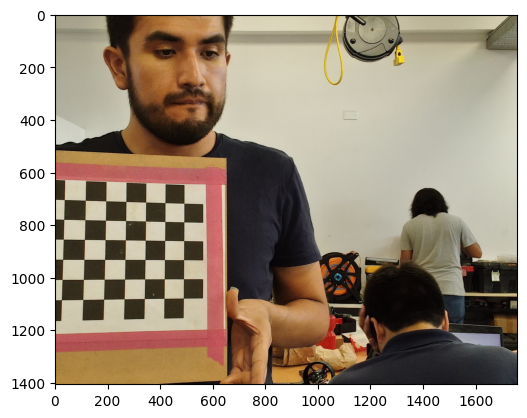

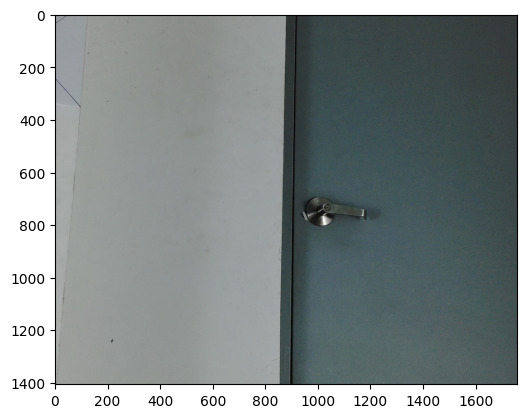

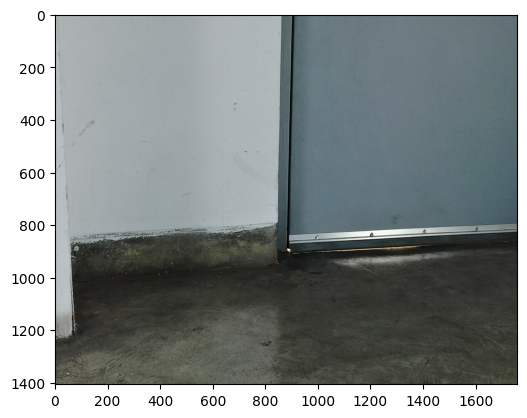

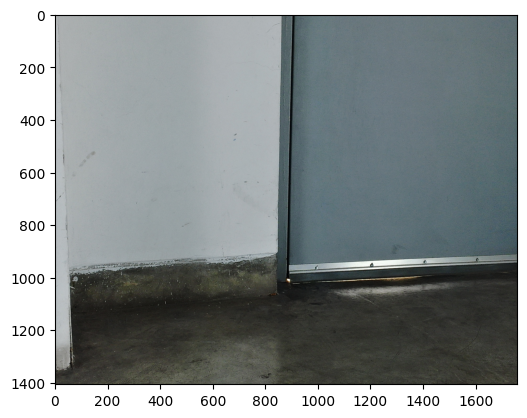

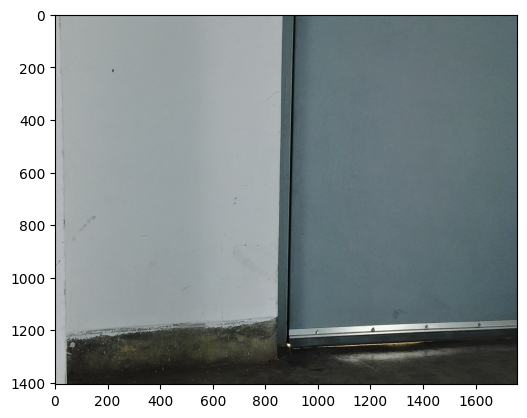

...

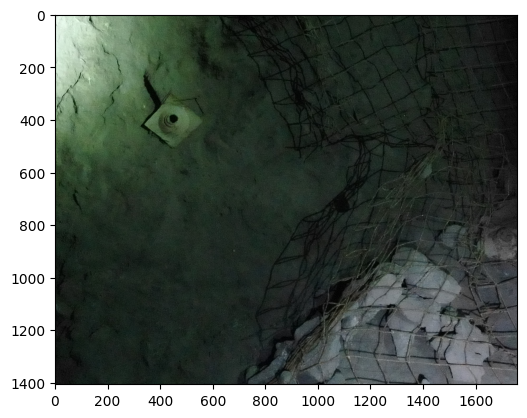

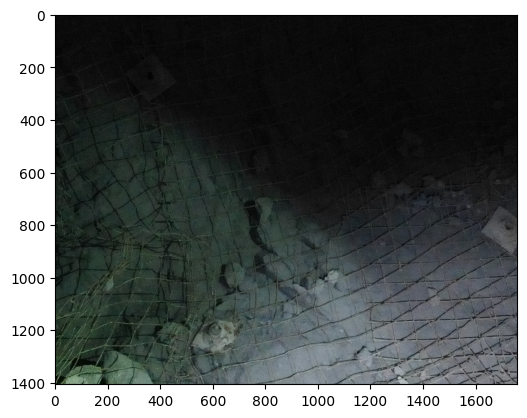

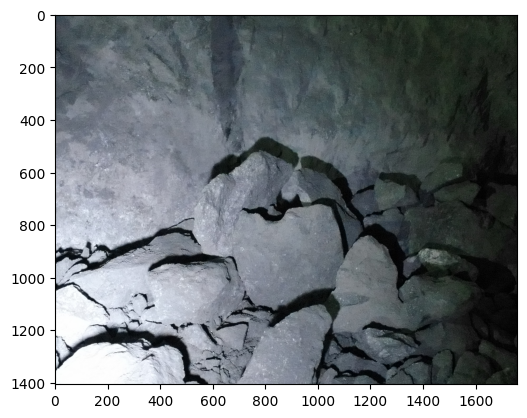

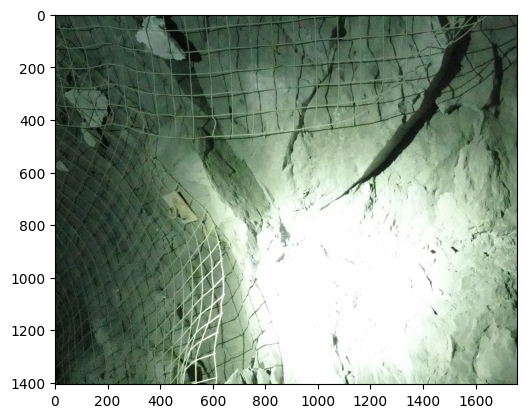

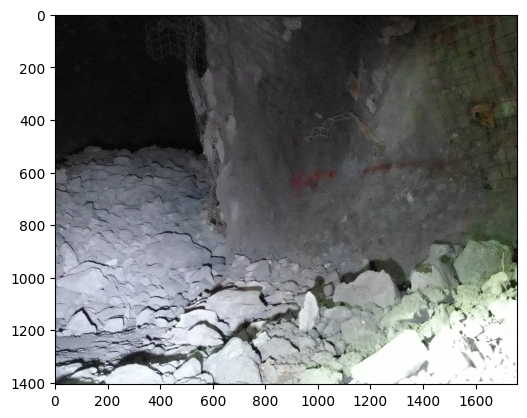

In [2]:
#CODIGO PARA LEER LA CANTIDAD DE IMAGENES TERMICAS CON LAS IMAGENES RGB
# CODIGO QUE ITERA EN LA CARPETA Y RECORTA LAS IMAGENES RGB PARA SU FUSION CON LAS IMAGENES TERMICAS


#LAS IMAGENES QUE SE DESEAN EVALUAR DEBEN IR EN LA CARPETA "imagenes"

import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import os

# Definir la cantidad de imágenes a procesar
cantidad_X = 70  # Puedes cambiar este valor según la cantidad de imágenes

# Definir la carpeta de las imágenes originales y la carpeta de destino para las imágenes recortadas
carpeta_imagenes = 'imagenes'
carpeta_destino = os.path.join(carpeta_imagenes, 'imagenes_recortadas')

# Posicionamiento del polígono
x = 26
vertices = np.array([[1200, 776-x], [1200, 2184-x], [2960, 2184-x], [2960, 776-x], [1200, 776-x]])  # Cerrar el polígono

for i in range(1, cantidad_X + 1):
    # Construir los nombres de archivo para las imágenes RGB
    rgb_filename = os.path.join(carpeta_imagenes, f'imagen_rgb_{i}.JPG')
    
    # Lectura de la imagen RGB
    I1 = cv2.imread(rgb_filename)
    if I1 is None:
        print(f"No se pudo leer la imagen RGB: {rgb_filename}")
        continue
    I2 = I1.astype(float)
    
    # Crear una máscara de borde negro y fondo blanco
    mask = np.zeros(I1.shape[:2], dtype=np.uint8)
    cv2.fillPoly(mask, [vertices], 255)
    
    # Poner la foto de la imagen RGB en el fondo negro
    I2_masked = I2.copy()
    I2_masked[:, :, 0] *= mask / 255
    I2_masked[:, :, 1] *= mask / 255
    I2_masked[:, :, 2] *= mask / 255
    I2_masked = I2_masked.astype(np.uint8)
    
    # Recortar una región de la imagen
    J = I2_masked[750:750+1406, 1200:1200+1759]
    
    # Guardar la imagen recortada
    recortada_filename = os.path.join(carpeta_destino, f'imagen_recortada_{i}.jpg')
    cv2.imwrite(recortada_filename, cv2.cvtColor(J, cv2.COLOR_BGR2RGB))
    
    # Mostrar la imagen recortada
    plt.imshow(cv2.cvtColor(J, cv2.COLOR_BGR2RGB))
    plt.show()



In [3]:
# CODIGO PARA FUSIONAR LAS IMAGENES TERMICAS QUE SE ENCUENTRAN DENTRO DE LA CARPETA imagenes_recortadas con las imagenes termicas

# 1. Method: DWT

import numpy as np
import cv2
from skimage import io, color, exposure
import matplotlib.pyplot as plt
import pywt
from PIL import Image
import os

def imgfusion(Im1, Im2, ftype, wtype):
    coeffs1 = pywt.dwt2(Im1.astype(float), wtype, 'periodization')
    coeffs2 = pywt.dwt2(Im2.astype(float), wtype, 'periodization')
    cA1, (cH1, cV1, cD1) = coeffs1
    cA2, (cH2, cV2, cD2) = coeffs2

    cA = np.zeros_like(cA1)
    cH = np.zeros_like(cH1)
    cV = np.zeros_like(cV1)
    cD = np.zeros_like(cD1)

    for i in range(cA1.shape[0]):
        for k in range(cA1.shape[1]):
            if ftype == 'MeanMax':
                cA[i, k] = np.mean([cA1[i, k], cA2[i, k]])
                cH[i, k] = np.max([cH1[i, k], cH2[i, k]])
                cV[i, k] = np.max([cV1[i, k], cV2[i, k]])
                cD[i, k] = np.max([cD1[i, k], cD2[i, k]])

    outimage = pywt.idwt2((cA, (cH, cV, cD)), wtype, 'periodization')
    return outimage

fusiontype = 'MeanMax'
wavetype = 'coif5'

#VALUE OF THE NUMBER OF IMAGES
num_images =  70 # Change this number depending on the number of images to process

for i in range(1, num_images + 1):
    img1_path = os.path.join('imagenes', 'imagenes_recortadas', f'imagen_recortada_{i}.jpg')
    img2_path = os.path.join('imagenes', f'imagen_termica_{i}.JPG')

    img1 = np.array(Image.open(img1_path))
    img2 = np.array(Image.open(img2_path))

    if img1.shape != img2.shape:
        img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0]))

    fusedimageR = imgfusion(img1[:, :, 0], img2[:, :, 0], fusiontype, wavetype)
    fusedimageG = imgfusion(img1[:, :, 1], img2[:, :, 1], fusiontype, wavetype)
    fusedimageB = imgfusion(img1[:, :, 2], img2[:, :, 2], fusiontype, wavetype)

    fusedimage = np.uint8(np.stack([fusedimageR, fusedimageG, fusedimageB], axis=-1))

    file_path = os.path.join('imagenes', 'DWT', f'FUSION_DWT_{i}.jpg')
    Image.fromarray(fusedimage).save(file_path, quality=100)

print("Fusion completed and images saved.")





Fusion completed and images saved.


In [4]:

# 2. METHOD Weight-Based Fusion

import numpy as np
import cv2
from PIL import Image
import os

def weighted_fusion(img_rgb, img_thermal, weight_rgb, weight_thermal, output_size=None):
    img_rgb = np.array(img_rgb)
    img_thermal = np.array(img_thermal)
    
    if output_size is not None:
        img_rgb = np.array(Image.fromarray(img_rgb).resize(output_size, Image.Resampling.LANCZOS))
        img_thermal = np.array(Image.fromarray(img_thermal).resize(output_size, Image.Resampling.LANCZOS))
    
    if len(img_thermal.shape) == 2:
        img_thermal = np.stack((img_thermal,)*3, axis=-1)
    
    img_rgb = img_rgb.astype(float) / 255
    img_thermal = img_thermal.astype(float) / 255
    
    fused_image = (img_rgb * weight_rgb + img_thermal * weight_thermal) / (weight_rgb + weight_thermal)
    fused_image = np.clip(fused_image * 255, 0, 255).astype(np.uint8)
    
    return fused_image



num_images = 100  # 

weight_rgb = 0.5
weight_thermal = 0.5

for i in range(1, num_images + 1):
    img1_path = os.path.join('imagenes', 'imagenes_recortadas', f'imagen_recortada_{i}.jpg')
    img2_path = os.path.join('imagenes', f'imagen_termica_{i}.JPG')

    img1 = np.array(Image.open(img1_path))
    img2 = np.array(Image.open(img2_path))

    if img1.shape != img2.shape:
        img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0]))

    fused_image = weighted_fusion(img1, img2, weight_rgb, weight_thermal)
    
    output_dir = os.path.join('imagenes', 'Ponderada')
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    file_path = os.path.join(output_dir, f'FUSION_Ponderada_{i}.jpg')
    Image.fromarray(fused_image).save(file_path, quality=100)

print("Fusion completed and images saved.")






Fusion completed and images saved.


In [5]:
# 3. Fusion Method based on the Laplace-Gauss transform

import numpy as np
import cv2
from PIL import Image
import os

def log_transform(image, sigma=1.0):
    blurred = cv2.GaussianBlur(image, (0, 0), sigma)
    log_image = cv2.Laplacian(blurred, cv2.CV_64F)
    return log_image

def fuse_images_log_color(rgb_image, thermal_image, sigma=1.0):
    thermal_gray = cv2.cvtColor(thermal_image, cv2.COLOR_RGB2GRAY)
    log_thermal = log_transform(thermal_gray, sigma)
    log_thermal_normalized = cv2.normalize(log_thermal, None, 0, 1, cv2.NORM_MINMAX)
    
    if rgb_image.shape[:2] != thermal_image.shape[:2]:
        thermal_image = cv2.resize(thermal_image, (rgb_image.shape[1], rgb_image.shape[0]))
    
    fused_image = cv2.addWeighted(rgb_image.astype(np.float64), 1.0, 
                                  (thermal_image * log_thermal_normalized[:,:,np.newaxis]).astype(np.float64), 1.0, 0)
    
    fused_image = cv2.normalize(fused_image, None, 0, 255, cv2.NORM_MINMAX)
    fused_image = np.uint8(fused_image)
    
    return fused_image

num_images = 100  # Cambia este número según la cantidad de imágenes a procesar

sigma = 1.0  # Valor sigma para la transformada LoG

for i in range(1, num_images + 1):
    img1_path = os.path.join('imagenes', 'imagenes_recortadas', f'imagen_recortada_{i}.jpg')
    img2_path = os.path.join('imagenes', f'imagen_termica_{i}.JPG')

    img1 = np.array(Image.open(img1_path))
    img2 = np.array(Image.open(img2_path))

    if img1.shape != img2.shape:
        img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0]))

    fused_image = fuse_images_log_color(img1, img2, sigma)
    
    output_dir = os.path.join('imagenes', 'LoG')
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    file_path = os.path.join(output_dir, f'FUSION_LoG_{i}.jpg')
    Image.fromarray(fused_image).save(file_path, quality=100)

print("Fusion completed and images saved.")




Fusion completed and images saved.


In [6]:
# 4. # Metodo Fusión basada en pirámide gaussiana:


import numpy as np
import cv2
from PIL import Image
import os

def gaussian_pyramid(image, levels):
    pyramid = [image]
    for _ in range(levels - 1):
        image = cv2.pyrDown(image)
        pyramid.append(image)
    return pyramid

def laplacian_pyramid(image, levels):
    gaussian = gaussian_pyramid(image, levels)
    pyramid = [gaussian[-1]]
    for i in range(levels - 1, 0, -1):
        expanded = cv2.pyrUp(gaussian[i])
        if expanded.shape[:2] != gaussian[i - 1].shape[:2]:
            expanded = cv2.resize(expanded, (gaussian[i - 1].shape[1], gaussian[i - 1].shape[0]))
        laplacian = cv2.subtract(gaussian[i - 1], expanded)
        pyramid.append(laplacian)
    return pyramid

def reconstruct_from_pyramid(pyramid):
    image = pyramid[0]
    for level in pyramid[1:]:
        image = cv2.pyrUp(image)
        if image.shape[:2] != level.shape[:2]:
            image = cv2.resize(image, (level.shape[1], level.shape[0]))
        image = cv2.add(image, level)
    return image

def gaussian_pyramid_fusion(image1, image2, levels):
    laplacian1 = laplacian_pyramid(image1, levels)
    laplacian2 = laplacian_pyramid(image2, levels)

    if image1.shape != image2.shape:
        image2 = cv2.resize(image2, (image1.shape[1], image1.shape[0]))

    mask = np.ones_like(image1)
    mask1 = gaussian_pyramid(mask, levels)
    mask2 = gaussian_pyramid(mask, levels)

    for i in range(len(laplacian1)):
        if laplacian1[i].shape != image1.shape:
            laplacian1[i] = cv2.resize(laplacian1[i], (image1.shape[1], image1.shape[0]))
        if laplacian2[i].shape != image2.shape:
            laplacian2[i] = cv2.resize(laplacian2[i], (image2.shape[1], image2.shape[0]))
        if mask1[i].shape != image1.shape:
            mask1[i] = cv2.resize(mask1[i], (image1.shape[1], image1.shape[0]))
        if mask2[i].shape != image2.shape:
            mask2[i] = cv2.resize(mask2[i], (image2.shape[1], image2.shape[0]))

    fused_pyramid = []
    for l1, l2, m1, m2 in zip(laplacian1, laplacian2, mask1, mask2):
        fused_rgb = 0.7 * m1 * l1 + 0.3 * m2 * l2
        fused_pyramid.append(fused_rgb)

    fused_image = reconstruct_from_pyramid(fused_pyramid)
    return fused_image

# VALOR IMPORTANTE
num_images = cantidad_X  # Cambia este número según la cantidad de imágenes a procesar

for i in range(1, num_images + 1):
    img1_path = os.path.join('imagenes', 'imagenes_recortadas', f'imagen_recortada_{i}.jpg')
    img2_path = os.path.join('imagenes', f'imagen_termica_{i}.JPG')

    img1 = np.array(Image.open(img1_path))
    img2 = np.array(Image.open(img2_path))

    if img1.shape != img2.shape:
        img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0]))

    levels = 4  # Número de niveles de la pirámide
    fused_image = gaussian_pyramid_fusion(img1, img2, levels)
    fused_image = fused_image.astype(np.uint8)

    output_dir = os.path.join('imagenes', 'Piramide_gaussiana')
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    file_path = os.path.join(output_dir, f'FUSION_Piramide_gaussiana_{i}.jpg')
    Image.fromarray(fused_image).save(file_path, quality=100)

print("Fusion completed and images saved.")





Fusion completed and images saved.


In [3]:
# histogramas
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

def histogram_based_fusion(img1, img2):
    # Calcular los histogramas de cada canal de color de la imagen RGB (img1)
    hist_img1_R = cv2.calcHist([img1], [0], None, [256], [0, 256])
    hist_img1_G = cv2.calcHist([img1], [1], None, [256], [0, 256])
    hist_img1_B = cv2.calcHist([img1], [2], None, [256], [0, 256])

    # Calcular el histograma de la imagen térmica (img2)
    if len(img2.shape) == 2:
        hist_img2 = cv2.calcHist([img2], [0], None, [256], [0, 256])
    else:
        hist_img2_R = cv2.calcHist([img2], [0], None, [256], [0, 256])
        hist_img2_G = cv2.calcHist([img2], [1], None, [256], [0, 256])
        hist_img2_B = cv2.calcHist([img2], [2], None, [256], [0, 256])
        hist_img2 = (hist_img2_R + hist_img2_G + hist_img2_B) / 3

    # Combinar los histogramas ponderados de cada canal
    fused_hist_R = 0.1 * hist_img1_R + 0.9 * hist_img2
    fused_hist_G = 0.1 * hist_img1_G + 0.9 * hist_img2
    fused_hist_B = 0.1 * hist_img1_B + 0.9 * hist_img2

    # Aplicar los histogramas ponderados para obtener la imagen fusionada
    fused_img_R = cv2.LUT(img1[:, :, 0], np.uint8(fused_hist_R))
    fused_img_G = cv2.LUT(img1[:, :, 1], np.uint8(fused_hist_G))
    fused_img_B = cv2.LUT(img1[:, :, 2], np.uint8(fused_hist_B))

    # Fusionar los canales de color en una sola imagen
    fused_img = cv2.merge([fused_img_R, fused_img_G, fused_img_B])

    return fused_img

# VALOR IMPORTANTE
num_images = 70  # Cambia este número según la cantidad de imágenes a procesar

# Directorio de salida para las imágenes fusionadas
output_dir = os.path.join('imagenes', 'Histograma')
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

for i in range(1, num_images + 1):
    img1_path = os.path.join('imagenes', 'imagenes_recortadas', f'imagen_recortada_{i}.jpg')
    img2_path = os.path.join('imagenes', f'imagen_termica_{i}.JPG')

    img1 = cv2.imread(img1_path)
    img2 = cv2.imread(img2_path)

    if img1 is None or img2 is None:
        print(f"Una de las imágenes no se pudo cargar: {img1_path}, {img2_path}")
        continue

    if img1.shape != img2.shape:
        img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0]))

    # Realizar la fusión de imágenes basada en histograma
    fused_image = histogram_based_fusion(img1, img2)

    # Guardar la imagen fusionada
    file_path = os.path.join(output_dir, f'FUSION_Histograma_{i}.jpg')
    cv2.imwrite(file_path, fused_image)

print("Fusion completed and images saved.")




Fusion completed and images saved.


In [7]:

#   COMPARATIVA LEYENDO LAS CARPETAS CORRESPONDIENTES PARA EVALUAR LOS VALORES NUMERICOS OBTENIDOS Y EN BASE A ELLO 
#   DECIDIR CUAL FUE EL MEJOR METODO


import os
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim
from PIL import Image

# Función para cargar una imagen dada su ruta
def load_image(image_path):
    return np.array(Image.open(image_path))

# Función para calcular el SSIM entre dos imágenes
def calculate_ssim(image1, image2):
    return ssim(image1, image2, win_size=7, channel_axis=-1)

# Función para redimensionar una imagen a un tamaño objetivo
def resize_image(image, target_size):
    return cv2.resize(image, (target_size[1], target_size[0]))

# Directorios de las imágenes
base_dir = 'imagenes'
recortadas_dir = os.path.join(base_dir, 'imagenes_manual_puntos')
fusion_directories = ['DWT', 'Ponderada', 'LoG', 'Piramide_gaussiana']

#VALOR IMPORTANTE A EVALUAR:
cantidad_X = 100

num_images = cantidad_X  # Cambia este número según la cantidad de imágenes a procesar

# Inicializar un diccionario para almacenar los SSIM para cada método
ssim_scores = {method: [] for method in fusion_directories}

# Dimensiones objetivo (ajustar según sea necesario)
target_size = (1759, 1406)  # (alto, ancho)

# Recorrer las imágenes y calcular los SSIM
for i in range(1, num_images + 1):
    # Cargar la imagen recortada RGB
    img_rgb_path = os.path.join(recortadas_dir, f'imagen_fusionada_manual_{i}.jpg')
    img_rgb = load_image(img_rgb_path)
    img_rgb = resize_image(img_rgb, target_size)
    
    for method in fusion_directories:
        # Cargar la imagen fusionada correspondiente
        fusion_img_path = os.path.join(base_dir, method, f'FUSION_{method}_{i}.jpg')
        fusion_img = load_image(fusion_img_path)
        fusion_img = resize_image(fusion_img, target_size)
        
        # Calcular el SSIM
        ssim_index = calculate_ssim(img_rgb, fusion_img)
        ssim_scores[method].append(ssim_index)

# Calcular y mostrar el promedio de SSIM para cada método
for method in ssim_scores:
    avg_ssim = np.mean(ssim_scores[method])
    print(f'Average SSIM for {method}: {avg_ssim:.4f}')

print(ssim_scores)




Average SSIM for DWT: 0.8661
Average SSIM for Ponderada: 0.8902
Average SSIM for LoG: 0.8553
Average SSIM for Piramide_gaussiana: 0.8573
{'DWT': [0.801333308701701, 0.910383459744418, 0.875205312972018, 0.903139746885197, 0.9029659746439544, 0.8969208654313695, 0.909980189689875, 0.9148270876465391, 0.9140614463034472, 0.9091969807919984, 0.9069954712852081, 0.9207507825577553, 0.902741630072217, 0.9132197910166631, 0.9114235592608475, 0.8969920747370196, 0.9206688392088278, 0.8572128267988027, 0.8181286464821095, 0.7894339988600086, 0.7973184933310936, 0.7667101372342785, 0.864967793020209, 0.8130954099316584, 0.7828477261586917, 0.7833615936016732, 0.8608631154996843, 0.8181319155584349, 0.8240034500365031, 0.8507870794010302, 0.8734409238956298, 0.84984387598323, 0.883027513830022, 0.8838354032906549, 0.8593557042108436, 0.8668863577243942, 0.8575103120606548, 0.871252270389116, 0.8566658000747035, 0.8950710229994362, 0.8750317169652666], 'Ponderada': [0.8222704092323543, 0.92533518